# Exploratory Data Analysis

#### Setup

In [15]:
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt

#### Load Data

In [16]:
shhs1 = pd.read_csv('/Users/nellieponarul/shhs/datasets/shhs1-dataset-0.16.0.csv')
shhs2 = pd.read_csv('/Users/nellieponarul/shhs/datasets/shhs2-dataset-0.16.0.csv', encoding='cp1252')
outcomes = pd.read_csv('/Users/nellieponarul/shhs/datasets/shhs-cvd-summary-dataset-0.16.0.csv')

In [17]:
outcomes.columns

Index(['nsrrid', 'pptid', 'vital', 'prev_mi', 'prev_mip', 'prev_stk', 'mi',
       'mip', 'mi_fatal', 'stroke', 'stk_fatal', 'chd_death', 'cvd_death',
       'angina', 'revasc_proc', 'ptca', 'cabg', 'chf', 'prev_chf', 'any_chd',
       'any_cvd', 'prev_revpro', 'mi_death', 'prev_ang', 'censdate', 'mi_date',
       'mip_date', 'stk_date', 'chd_dthdt', 'cvd_dthdt', 'ang_date',
       'revpro_date', 'ptca_date', 'cabg_date', 'chf_date', 'visitnumber',
       'afibprevalent', 'afibincident', 'gender', 'race', 'age_s1'],
      dtype='object')

#### Summarize missing values by outcome

In [18]:
outcome_vars = ['nsrrid', 'vital', 'prev_mi', 'prev_mip', 'prev_stk', 'mi',
       'mip', 'mi_fatal', 'stroke', 'stk_fatal', 'chd_death', 'cvd_death',
       'angina', 'revasc_proc', 'ptca', 'cabg', 'chf', 'prev_chf', 'any_chd',
       'any_cvd', 'prev_revpro', 'mi_death', 'prev_ang',  'mi_date',
       'mip_date', 'stk_date', 'chd_dthdt', 'cvd_dthdt', 'ang_date',
       'revpro_date', 'ptca_date', 'cabg_date', 'chf_date',
       'afibprevalent', 'afibincident']

How many individuals appear in SHHS1 and SHHS2 and have CVD outcome `cvd_death`?

In [19]:
shhs1_ids = shhs1.nsrrid.unique()
shhs2_ids = shhs2.nsrrid.unique()
outcomes_ids = outcomes.loc[~outcomes.cvd_death.isna()].nsrrid.unique()
# outcomes_ids = outcomes.nsrrid.unique()
shared_ids = list(set(shhs1_ids) & set(shhs2_ids) & set(outcomes_ids))

In [20]:
len(list(set(shhs1_ids) & set(shhs2_ids) & set(outcomes_ids)))
# outcomes_ids

4080

What is the age range of this cohort?

In [21]:
print(min(shhs1.age_s1), max(shhs1.age_s1))

39 90


In [22]:
print(min(shhs1.loc[shhs1.nsrrid.isin(list(set(shhs1_ids) & set(shhs2_ids) & set(outcomes_ids)))].age_s1), max(shhs1.loc[shhs1.nsrrid.isin(list(set(shhs1_ids) & set(shhs2_ids) & set(outcomes_ids)))].age_s1))

39 90


What location sites did these participants come from? 

(array([343., 410., 355., 231., 265., 469., 501., 517., 477., 512.]),
 array([  77.,  653., 1229., 1805., 2381., 2957., 3533., 4109., 4685.,
        5261., 5837.]),
 <BarContainer object of 10 artists>)

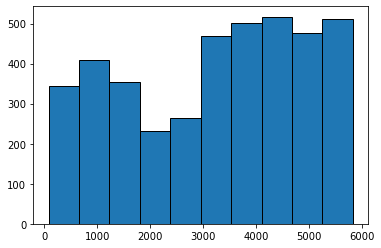

In [23]:
plt.hist(outcomes.loc[outcomes.nsrrid.isin(list(set(shhs1_ids) & set(shhs2_ids) & set(outcomes_ids)))].pptid, edgecolor = 'black')

#### Explore Covariates  

Limited to those suggested by Dr. Wang: 

sleep predictors:
Sleep architecture – supinep, slpeffp, slpprdp, timeremp, times34p, timest1p, timest2p, waso  
Polysomnography (osa) – rdi3p, ai_all, avgsat, minsat  
Questionnaire – ess_s1, saqli, fosq, hosnr02, legcrp02, sh308a-sh308f    

saqli, fosq, sh308a-sh308f are only available for visit 2

 
Other predictors/covariates to consider:  
Anthropometry – bmi_s1, height, waist, neck20  
Demography – gender, race, educat, age_s1, mstat  
General Health – bp_s1, gh_s1, mcs_s1, mh_s1, pcs_s1, pf_s1  
Clinical data – chol, hdl, trig, diasbp, systbp, fev1, fvc  

In [24]:
pred_cols = ['supinep', 'slpeffp', 'slpprdp', 'timeremp', 'times34p', 'timest1p', 
             'timest2p', 'waso', 'rdi3p', 'ai_all', 'avgsat', 'minsat', 'ess_s1', 
             'hosnr02', 'legcrp02', 'bmi_s1', 'height', 'waist', 'neck20', 
             'gender', 'race', 'educat', 'age_s1', 'mstat', 'bp_s1', 'gh_s1',
             'mcs_s1', 'mh_s1', 'pcs_s1', 'pf_s1', 'chol', 'hdl', 'trig', 
             'diasbp', 'systbp', 'fev1', 'fvc', 'saqli', 'fosq', 'sh308a',
             'sh308b', 'sh308c', 'sh308d', 'sh308e', 'sh308f']

In [25]:
shhs1.columns = shhs1.columns.str.lower()
shhs2.columns = shhs2.columns.str.lower()

In [26]:
shhs1 = shhs1[[p for p in pred_cols if p in shhs1.columns]]
shhs2 = shhs2[[p for p in pred_cols if p in shhs2.columns]]
outcomes = outcomes[[p for p in outcome_vars if p in outcomes.columns]]

In [27]:
print(len(shhs1.columns), len(shhs2.columns), len(outcomes.columns))

37 23 35


Create profiling reports for EDA

In [28]:
from pandas_profiling import ProfileReport

In [29]:
profile1 = ProfileReport(shhs1, title="SHHS1 Exploratory Data Analysis", explorative=True)
profile2 = ProfileReport(shhs2, title="SHHS2 Exploratory Data Analysis", explorative=True)
profile3 = ProfileReport(outcomes, title="CVD Outcomes Exploratory Data Analysis", explorative=True)

In [30]:
profile3.to_notebook_iframe() 

Summarize dataset:   0%|          | 0/48 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]